In [ ]:
#Gerekli olan kutuphaneler yuklenir
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [ ]:
#Dataset alinir
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 20.02 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [ ]:
# csv dosya okunur
train_df = pd.read_csv("nih/train-small.csv")
# ilk 10 satira goz attim
# Toplamda 1000 satirlik bir veri seti oldugunu gordum
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head(10)

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0
5,00001232_002.png,1,1,0,0,1,0,0,0,1,0,0,1232,0,0,0
6,00017135_000.png,0,0,0,0,0,0,0,0,0,0,0,17135,0,0,0
7,00027235_000.png,0,0,0,0,0,0,0,0,0,0,0,27235,0,0,0
8,00014197_007.png,0,0,0,0,0,0,0,0,0,0,0,14197,0,0,0
9,00011584_002.png,0,0,0,0,0,0,0,0,0,0,0,11584,0,0,0


In [ ]:
# Toplam kolon sayisi, kolon isimleri, veri tipleri ve null olma durumuna bakildi
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

In [ ]:
# Toplamda 928 farkli hasta kaydi oldugu goruldu
# PatientId bazinda birden fazla kaydi olan hastalarin diger kayitlari siliniyor.
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")
train_df = train_df.drop_duplicates(subset=['PatientId'])
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 
The total patient ids are 928, from those the unique ids are 928 


In [ ]:
# kolon isimleri icin bir list olusturuluyor
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Verisi anlamsiz olacagi icin iki kolon listeden silinir
columns.remove('Image')
columns.remove('PatientId')
# kolon isimleri tekrar yazdiriliyor
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Her bir hastalik icin pozitif deger toplamlari yazdiriliyor
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 94 samples
The class Cardiomegaly has 19 samples
The class Consolidation has 27 samples
The class Edema has 16 samples
The class Effusion has 107 samples
The class Emphysema has 12 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 159 samples
The class Mass has 41 samples
The class Nodule has 51 samples
The class Pleural_Thickening has 18 samples
The class Pneumonia has 9 samples
The class Pneumothorax has 33 samples


Display Random Images


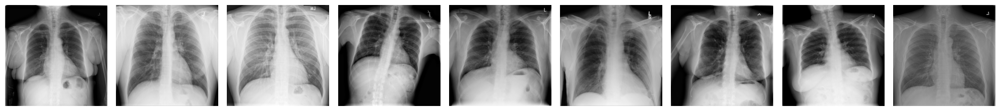

In [ ]:
# Görüntüler okunuyor
images = train_df['Image'].values

# Rasgele 9 resim, tekrarsız olacak şekilde ele alınır
random_images = [np.random.choice(images, replace=False) for i in range(9)]

# dosya yolu verilir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Resimler için en-boy oranı verilir
plt.figure(figsize=(20,10))

# Bu 9 resim yanyana ekrana yazdırılır
for i in range(9):
    plt.subplot(1, 9, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')
plt.tight_layout()

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4406 and the standard deviation is 0.2724


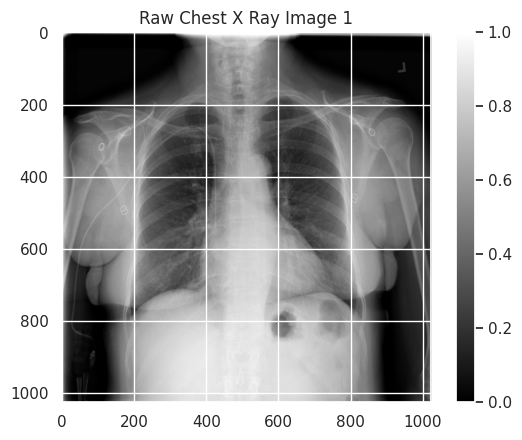

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9961 and the minimum is 0.0157
The mean value of the pixels is 0.6598 and the standard deviation is 0.1968


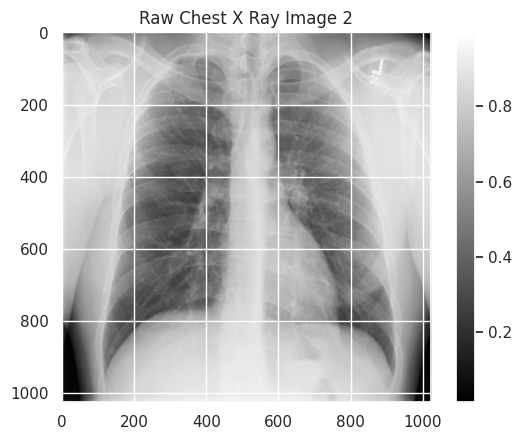

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9059 and the minimum is 0.0000
The mean value of the pixels is 0.6388 and the standard deviation is 0.1669


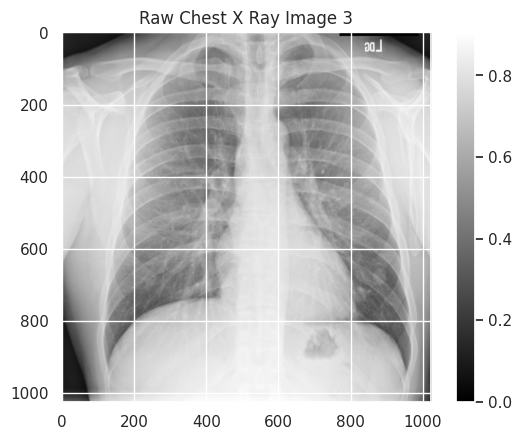

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4035 and the standard deviation is 0.2887


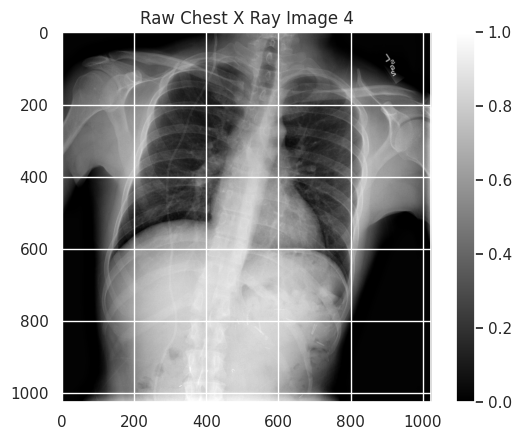

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4776 and the standard deviation is 0.2394


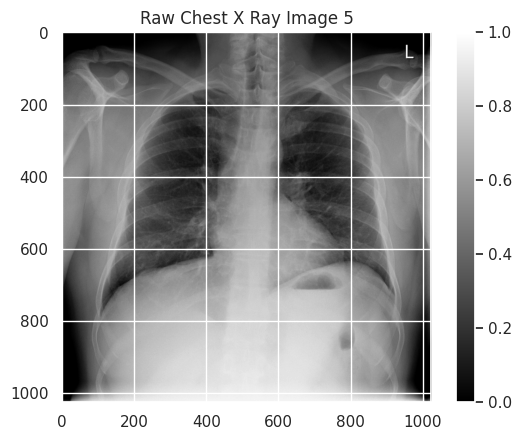

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.8863 and the minimum is 0.0000
The mean value of the pixels is 0.4469 and the standard deviation is 0.2119


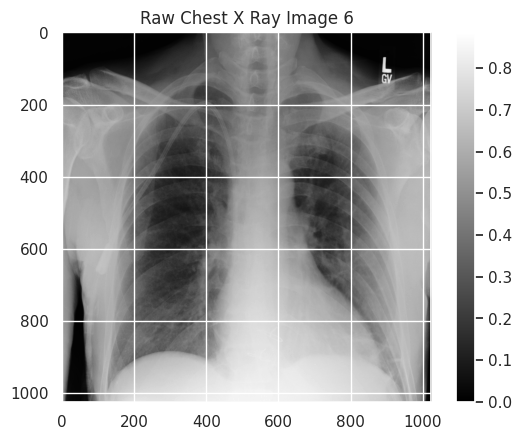

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4356 and the standard deviation is 0.2614


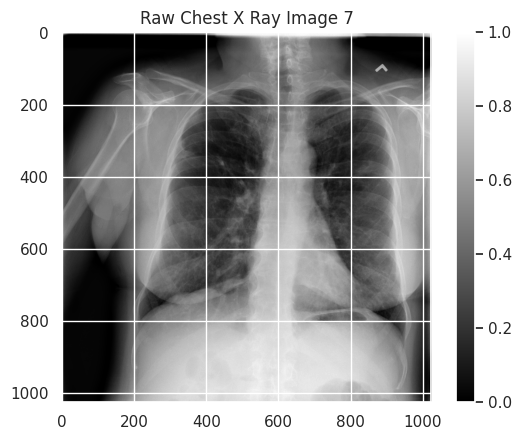

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 0.9765 and the minimum is 0.0000
The mean value of the pixels is 0.4553 and the standard deviation is 0.2979


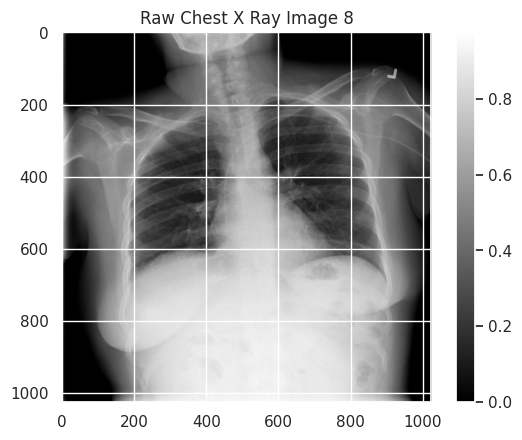

The dimensions of the image are 1024 pixels width and 1024 pixels height, one single color channel
The maximum pixel value is 1.0000 and the minimum is 0.0000
The mean value of the pixels is 0.4190 and the standard deviation is 0.1476


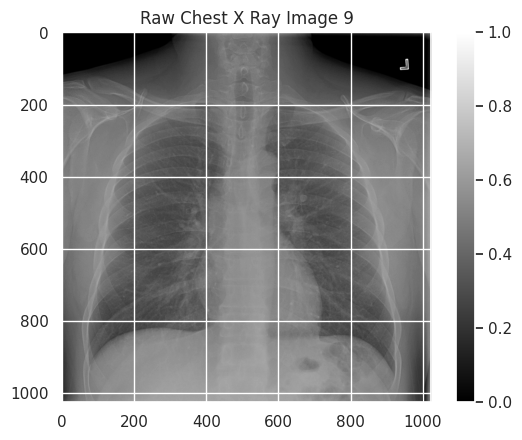

In [ ]:
# Bu 9 goruntu icin;
# Maksimum, minimum piksel hesaplanir,
# Standart Sapmasi bulunur
for i in range(9):
  sample_img = random_images[i]
  raw_image = plt.imread(os.path.join(img_dir, sample_img))
  plt.imshow(raw_image, cmap='gray')
  plt.colorbar()
  plt.title(f'Raw Chest X Ray Image {i+1}')
  print(f"The dimensions of the image are {raw_image.shape[0]} pixels width and {raw_image.shape[1]} pixels height, one single color channel")
  print(f"The maximum pixel value is {raw_image.max():.4f} and the minimum is {raw_image.min():.4f}")
  print(f"The mean value of the pixels is {raw_image.mean():.4f} and the standard deviation is {raw_image.std():.4f}")
  plt.show()
# Tüm resimler için boyut : 1024 * 1024 piksel
# Maximum ve minimum değerlerin 0 - 1 aralığında olduğu görülmektedir.
# Görüntülerin genel parlaklık ve standart sapma değerleri değişkenlik göstermektedir.

<ipython-input-19-21a01e667261>:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(raw_image.ravel(),


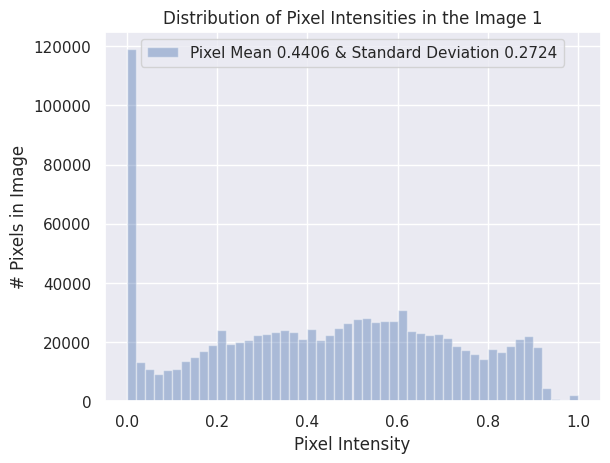

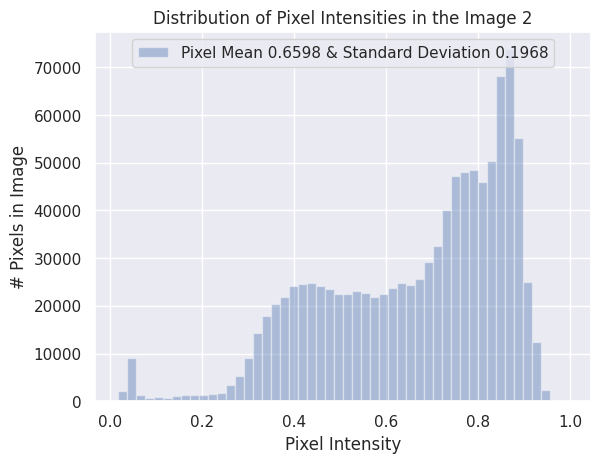

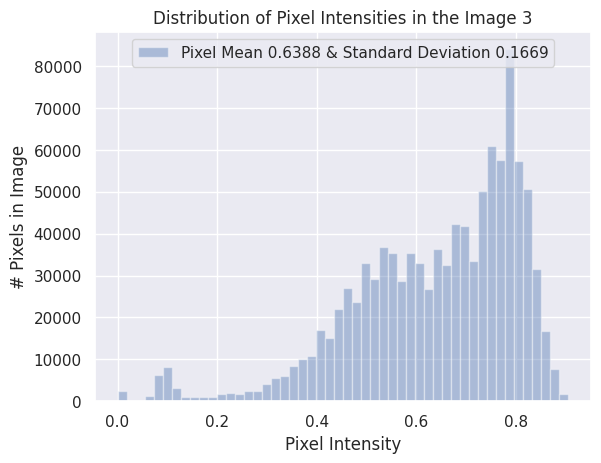

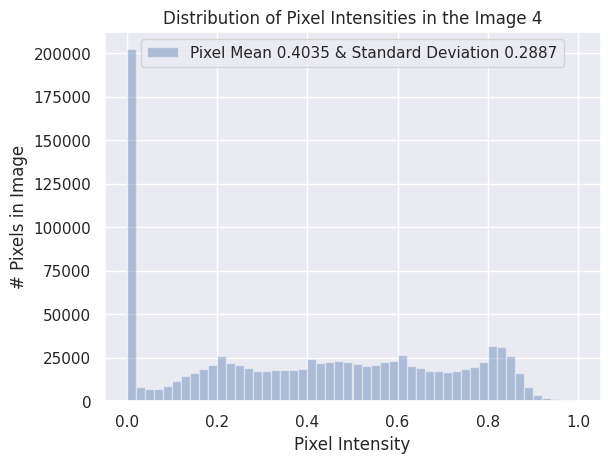

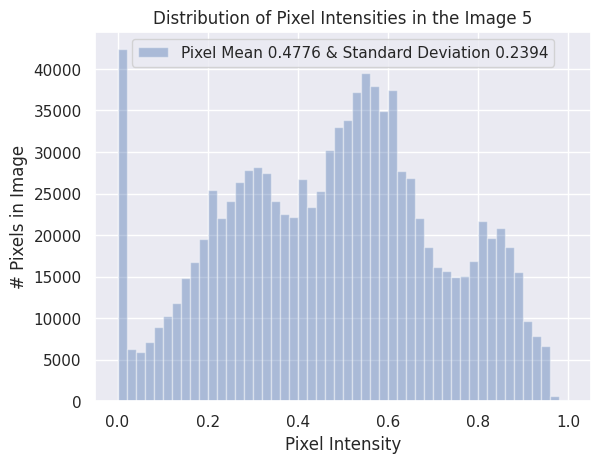

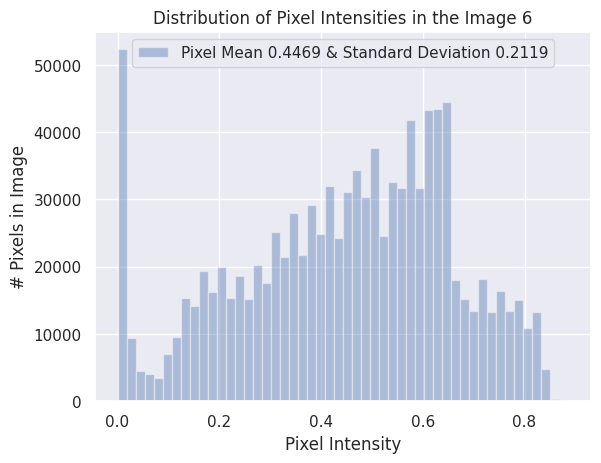

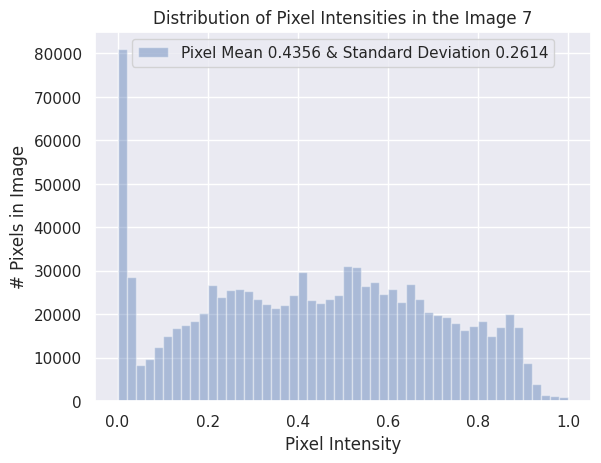

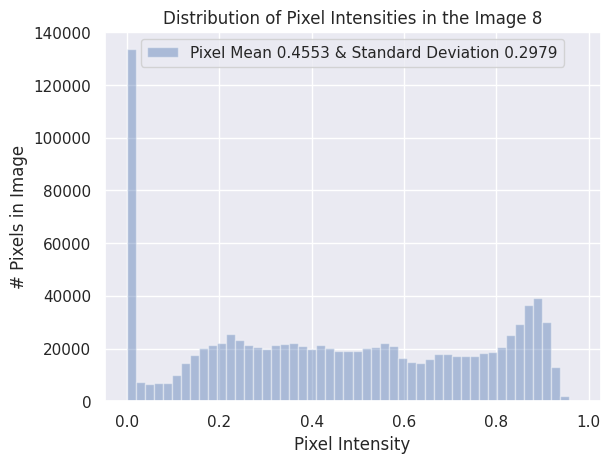

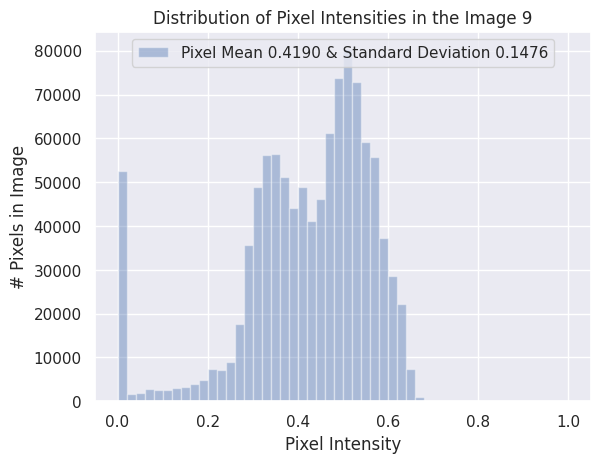

In [ ]:
# Piksel yoğunluklarının histogramı çizdirilir.
for i in range(9):
  sample_img = random_images[i]
  raw_image = plt.imread(os.path.join(img_dir, sample_img))
  sns.distplot(raw_image.ravel(),
              label=f'Pixel Mean {np.mean(raw_image):.4f} & Standard Deviation {np.std(raw_image):.4f}', kde=False)
  plt.legend(loc='upper center')
  plt.title(f'Distribution of Pixel Intensities in the Image {i+1}')
  plt.xlabel('Pixel Intensity')
  plt.ylabel('# Pixels in Image')
  plt.show()
# Görüntü 1 için bakacak olursak;
# X ekseninde 0'a yakın olan tepe noktası düşük yoğunluklu piksellerin (karanlık) olduğunu gösteriyor.
# Grafiğin geri kalan kısımları görüntünün yoğunluk değerlerinde nispeten eşit bir dağılım olduğunu gösteriyor.

# Görüntü 2 için bakacak olursak;
# Genel parlaklık düzeyinin (0,6598) orta seviyenin üzerinde olduğunu gösteriyor.
# Piksel yoğunluklarının 0.6 ile 0.9 aralığında olması, görüntünün açık tonlarda olduğunu gösteriyor.

# Görüntü 9 için bakacak olursak;
# Genel parlaklık düzeyinin (0,4190) orta seviyenin altında olduğunu gösteriyor.
# Standart sapmanın düşük olması, görüntünün kontrastının düşük olduğunu gösteriyor.
# Histogramın sağ tarafının (0.7 ve sonrası) boş olması parlak alanların az olduğunu gösteriyor.

In [ ]:
pip install numpy

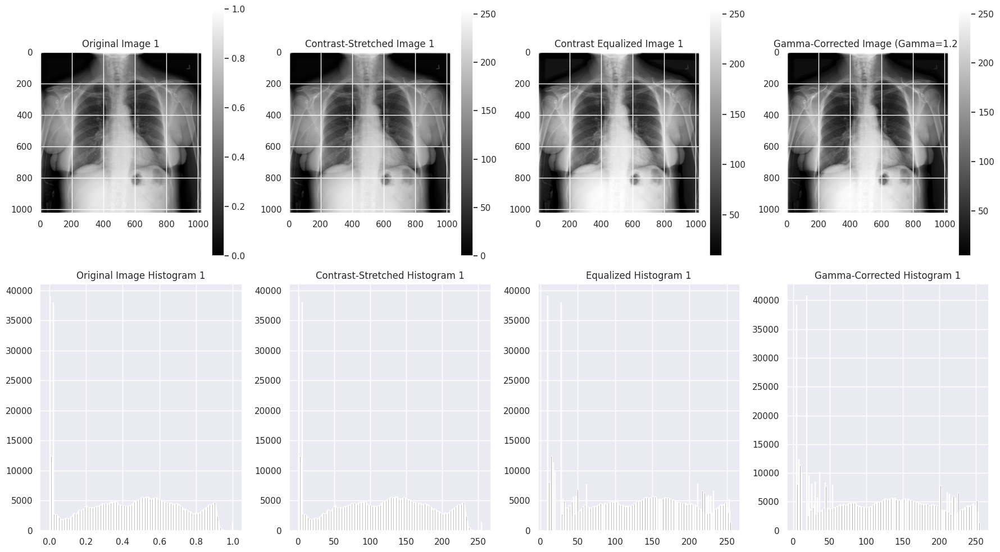

<ipython-input-24-a9035ea8ed60>:73: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(gamma_corrected.ravel(),


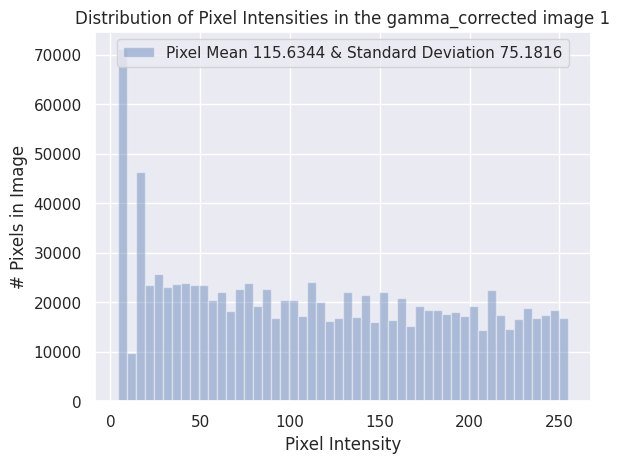

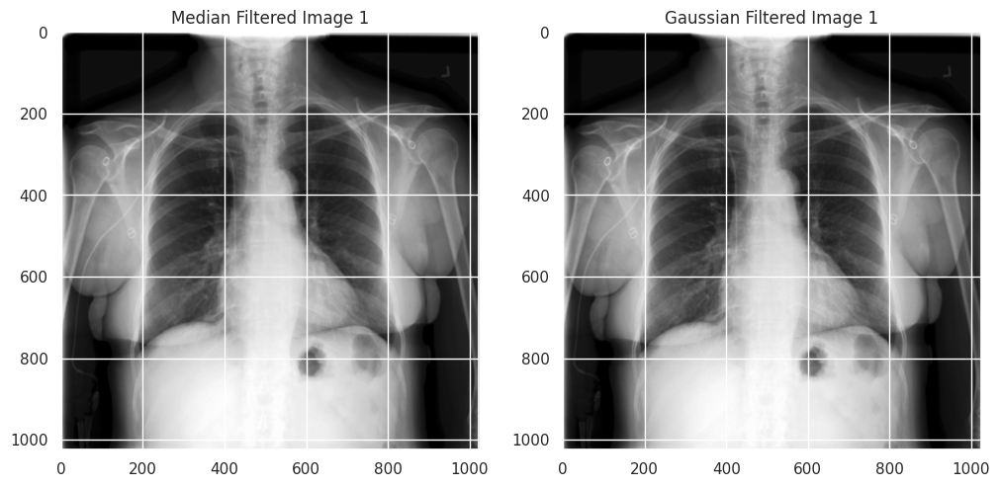

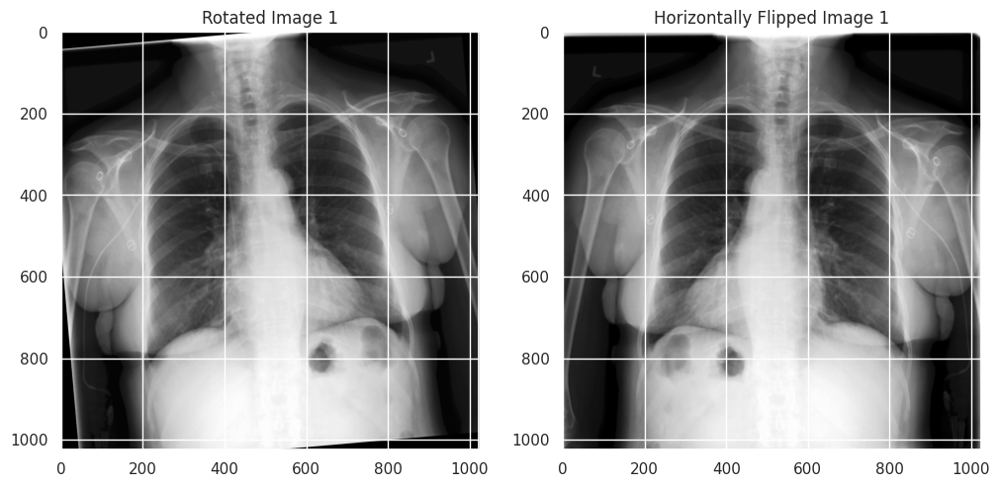

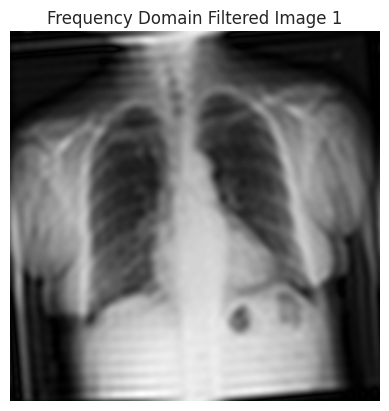

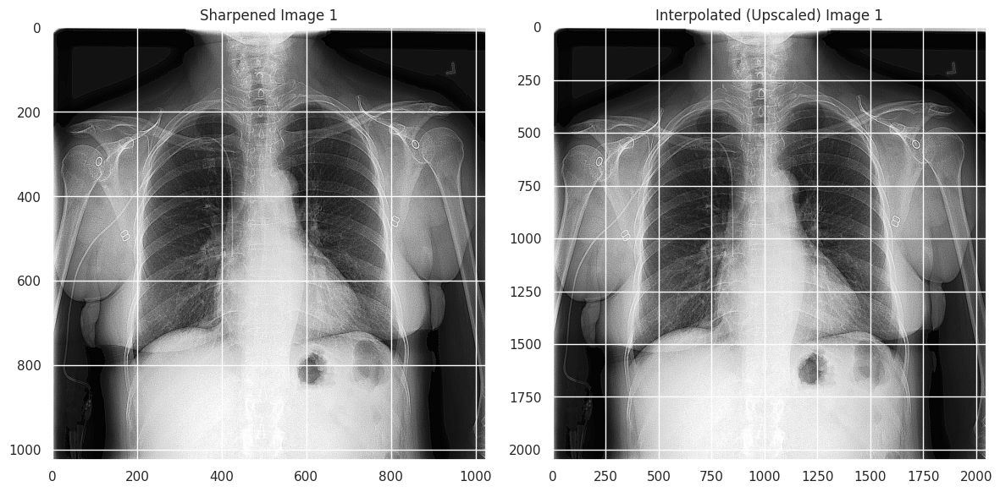

...

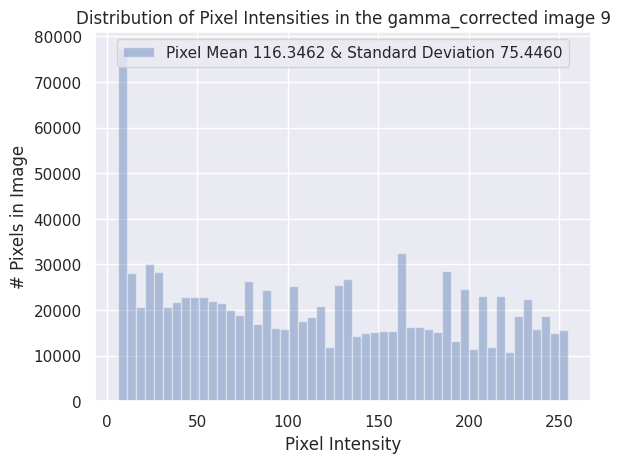

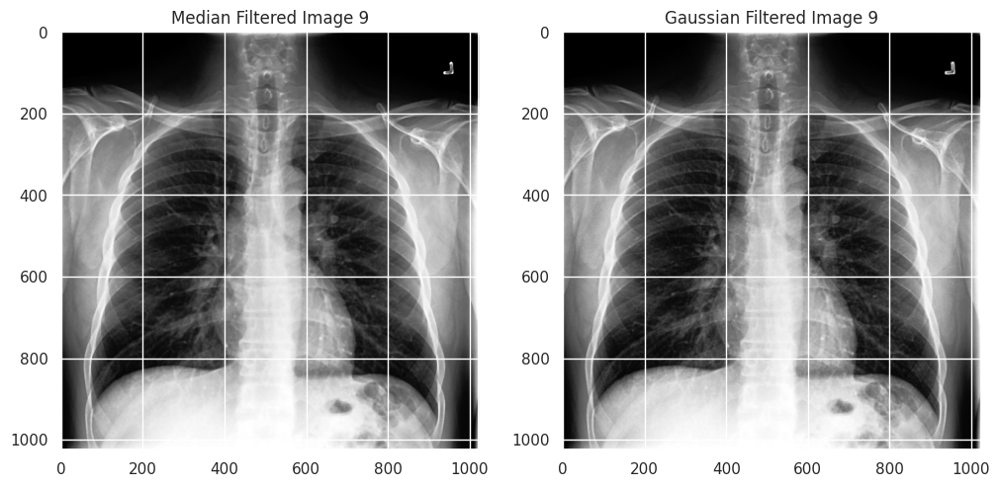

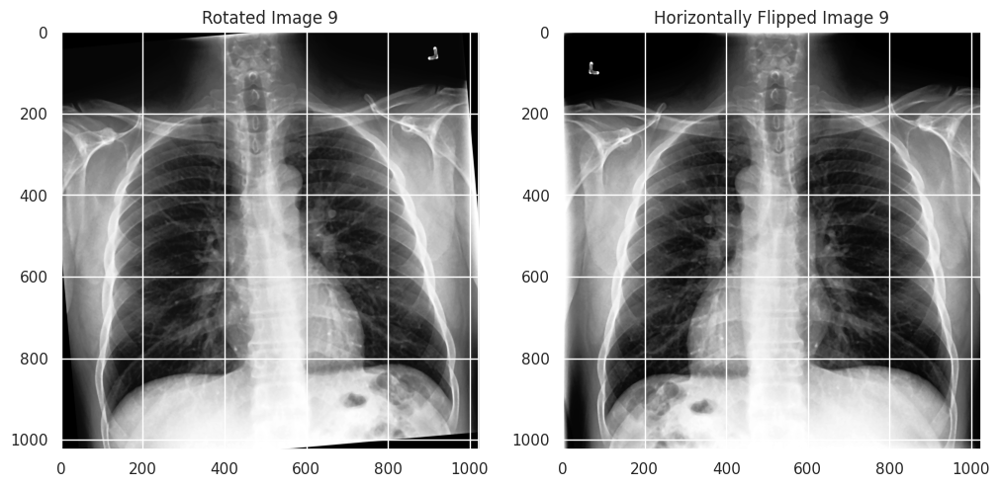

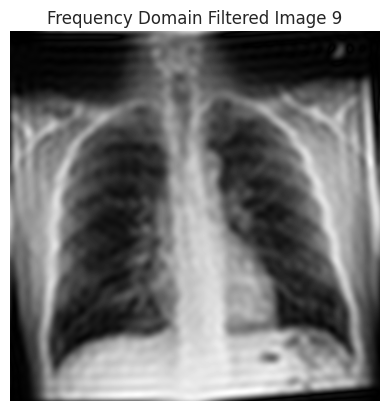

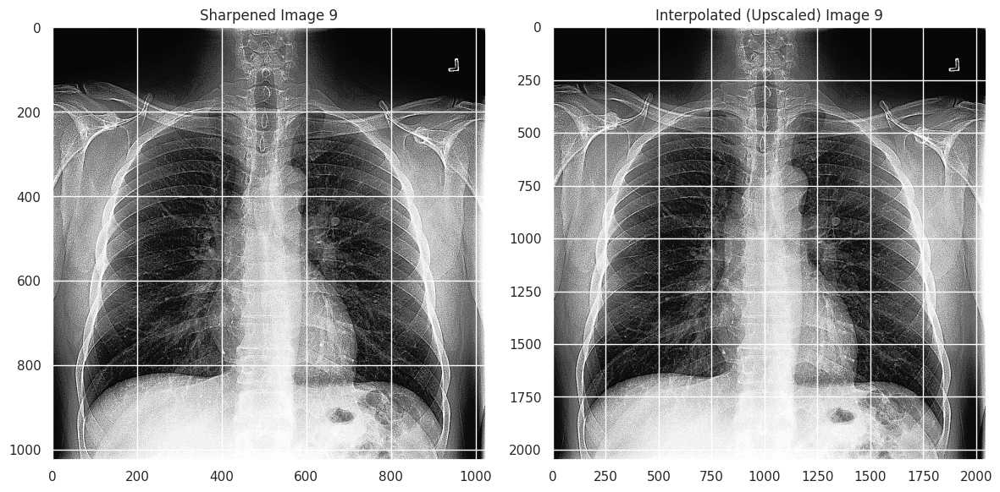

In [ ]:
from skimage import exposure
import cv2
from scipy.ndimage import zoom

for i in range(9):
  sample_img = random_images[i]
  raw_image = plt.imread(os.path.join(img_dir, sample_img))

  # Kontrast germe işlemi için max ve min değerleri bulunuyor
  min_val, max_val = raw_image.min(), raw_image.max()

  # Adım 1 Kontrast germe işlemi yapılıyor
  min_val, max_val = raw_image.min(), raw_image.max()
  contrast_stretched = (raw_image - min_val) / (max_val - min_val)
  contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

  # Adım 2: Kontrast germe işlemi sonrası histogram eşitlemesi yapılır
  # Adım 2: Historam eşitleme skimage kullanılarak yapılıyor
  equalized_image = exposure.equalize_hist(contrast_stretched)
  equalized_image = (equalized_image * 255).astype(np.uint8)


  # Adım 3: Eşitleme yapılmış görüntüye gamma düzeltmesi uygulanıyor
  gamma = 1.2  # Gamma değeri 1.2 seçiliyor
  gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
  gamma_corrected = gamma_corrected.astype(np.uint8)

  # Orijinal Görüntü gösterilir
  # Orijinal Histogram gösterilir
  plt.figure(figsize=(18, 10))
  plt.subplot(2, 4, 1)
  plt.imshow(raw_image, cmap='gray')
  plt.title(f'Original Image {i+1}')
  plt.colorbar()
  plt.subplot(2, 4, 5)
  plt.hist(raw_image.ravel(), bins=256, color='gray')
  plt.title(f"Original Image Histogram {i+1}")

  # Kontrast Germe yapılmış görüntü gösterilir
  # Kontrast Germe yapılmış Histogram gösterilir
  plt.subplot(2, 4, 2)
  plt.imshow(contrast_stretched, cmap='gray')
  plt.title(f'Contrast-Stretched Image {i+1}')
  plt.colorbar()
  plt.subplot(2, 4, 6)
  plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
  plt.title(f"Contrast-Stretched Histogram {i+1}")

  # Eşitleme yapılmış görüntü gösterilir
  # Eşitleme yapılmış Histogram gösterilir
  plt.subplot(2, 4, 3)
  plt.imshow(equalized_image, cmap='gray')
  plt.title(f'Contrast Equalized Image {i+1}')
  plt.colorbar()
  plt.subplot(2, 4, 7)
  plt.hist(equalized_image.ravel(), bins=256, color='gray')
  plt.title(f"Equalized Histogram {i+1}")

  # Gamma düzeltme yapılmış görüntü gösterilir
  # Gamma düzeltme yapılmış Histogram gösterilir
  plt.subplot(2, 4, 4)
  plt.imshow(gamma_corrected, cmap='gray')
  plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
  plt.colorbar()
  plt.subplot(2, 4, 8)
  plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
  plt.title(f"Gamma-Corrected Histogram {i+1}")

  plt.tight_layout()
  plt.show()
  # Gamma düzeltme yapılmış görüntü için histogram cizdirilir
  # ****************************************************
  sns.distplot(gamma_corrected.ravel(),
             label=f'Pixel Mean {np.mean(gamma_corrected):.4f} & Standard Deviation {np.std(gamma_corrected):.4f}', kde=False)
  plt.legend(loc='upper center')
  plt.title(f'Distribution of Pixel Intensities in the gamma_corrected image {i+1}')
  plt.xlabel('Pixel Intensity')
  plt.ylabel('# Pixels in Image')
  # ****************************************************

  # ****************************************************
  # Görüntülere Median Blur filtreleme uygulanır
  median_filtered = cv2.medianBlur(gamma_corrected, 5)

  # Görüntülere Gaussian Blur filtreleme uygulanır
  gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

  # Sonuçlar Gösterilir
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1), plt.imshow(median_filtered, cmap='gray'), plt.title(f"Median Filtered Image {i+1}")
  plt.subplot(1, 2, 2), plt.imshow(gaussian_filtered, cmap='gray'), plt.title(f"Gaussian Filtered Image {i+1}")
  plt.show()
  # ****************************************************

  # ****************************************************
  # Görüntü 5 derece açı ile döndürülür
  center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
  rotation_matrix = cv2.getRotationMatrix2D(center, angle=5, scale=1.0)
  rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

  # Görüntü yatay olarak çevirilir
  flipped_horizontal = cv2.flip(median_filtered, 1)

  # Dndürülen ve yatay çevirilen görüntüler ekranda gösterilir
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1), plt.imshow(rotated_image, cmap='gray'), plt.title(f"Rotated Image {i+1}")
  plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title(f"Horizontally Flipped Image {i+1}")
  plt.show()
  # ****************************************************

  # ****************************************************
  # Fourier dönüşümü işlemi ile düşük frekanslar görüntünün merkezine kaydırılır
  dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
  dft_shifted = np.fft.fftshift(dft)

  # Filtreleme için bir maskeleme işlemi yapılır
  rows, cols = rotated_image.shape
  crow, ccol = rows // 2 , cols // 2
  mask = np.zeros((rows, cols, 2), np.uint8)
  mask[crow-30:crow+30, ccol-30:ccol+30] = 1

  # Maske uygulanır ve tesr Fourier dönüşümü yapılır. Bu sayede görüntü üzerindeki gürültü temizleme işlemi yapılmış olur.
  fshift = dft_shifted * mask
  f_ishift = np.fft.ifftshift(fshift)
  filtered_image = cv2.idft(f_ishift)
  filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

  # Filtrelenmiş Görüntü normalize edilir (0 ile 255 piksel arasında ölçekleme)
  filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
  plt.imshow(filtered_image, cmap='gray')
  plt.title(f"Frequency Domain Filtered Image {i+1}")
  plt.axis("off")
  plt.show()
  # ****************************************************

  # ****************************************************
  # Adım 4: Unsharp mask yöntemi ile keskinleştirme işlemi yapılır
  sharpening_kernel = np.array([[-1, -1, -1],
                                [-1,  9, -1],
                                [-1, -1, -1]])
  sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

  # Adım 5: Bicubic enterpolasyon ile keskinleştirilmiş görüntü 2 kat büyütülür
  scale_factor = 2
  resized_image = zoom(sharpened_image, scale_factor, order=3)

  # İki görüntü ekrana yazdırılır
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'),plt.title(f"Sharpened Image {i+1}")
  plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'),plt.title(f"Interpolated (Upscaled) Image {i+1}")


  plt.tight_layout()
  plt.show()
  # ****************************************************

  # ****************************************************

In [ ]:
# Yukarıdaki kod bloğu kopyalandı
# Dönme açısı 8 Derece verildi.
# Gamma Düzeltme Değeri 1.5 olarak verildi.
# iki sonuç arasında Gamma Düzeltme değeri 1.5 olarak verilen kod bloğunun daha keskin değerler getirdiği görüldü.
# GitHub sistemine yüklemede hata aldığım için aşağıdaki kod bloğunun çıktıları kaldırıldı.
from skimage import exposure
import cv2
from scipy.ndimage import zoom

for i in range(9):
  sample_img = random_images[i]
  raw_image = plt.imread(os.path.join(img_dir, sample_img))

  # Kontrast germe işlemi için max ve min değerleri bulunuyor
  min_val, max_val = raw_image.min(), raw_image.max()

  # Adım 1 Kontrast germe işlemi yapılıyor
  min_val, max_val = raw_image.min(), raw_image.max()
  contrast_stretched = (raw_image - min_val) / (max_val - min_val)
  contrast_stretched = (contrast_stretched * 255).astype(np.uint8)

  # Adım 2: Kontrast germe işlemi sonrası histogram eşitlemesi yapılır
  # Adım 2: Historam eşitleme skimage kullanılarak yapılıyor
  equalized_image = exposure.equalize_hist(contrast_stretched)
  equalized_image = (equalized_image * 255).astype(np.uint8)


  # Adım 3: Eşitleme yapılmış görüntüye gamma düzeltmesi uygulanıyor
  gamma = 1.5  # Gamma değeri 1.5 seçiliyor
  gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
  gamma_corrected = gamma_corrected.astype(np.uint8)

  # Orijinal Görüntü gösterilir
  # Orijinal Histogram gösterilir
  plt.figure(figsize=(18, 10))
  plt.subplot(2, 4, 1)
  plt.imshow(raw_image, cmap='gray')
  plt.title(f'Original Image {i+1}')
  plt.colorbar()
  plt.subplot(2, 4, 5)
  plt.hist(raw_image.ravel(), bins=256, color='gray')
  plt.title(f"Original Image Histogram {i+1}")

  # Kontrast Germe yapılmış görüntü gösterilir
  # Kontrast Germe yapılmış Histogram gösterilir
  plt.subplot(2, 4, 2)
  plt.imshow(contrast_stretched, cmap='gray')
  plt.title(f'Contrast-Stretched Image {i+1}')
  plt.colorbar()
  plt.subplot(2, 4, 6)
  plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
  plt.title(f"Contrast-Stretched Histogram {i+1}")

  # Eşitleme yapılmış görüntü gösterilir
  # Eşitleme yapılmış Histogram gösterilir
  plt.subplot(2, 4, 3)
  plt.imshow(equalized_image, cmap='gray')
  plt.title(f'Contrast Equalized Image {i+1}')
  plt.colorbar()
  plt.subplot(2, 4, 7)
  plt.hist(equalized_image.ravel(), bins=256, color='gray')
  plt.title(f"Equalized Histogram {i+1}")

  # Gamma düzeltme yapılmış görüntü gösterilir
  # Gamma düzeltme yapılmış Histogram gösterilir
  plt.subplot(2, 4, 4)
  plt.imshow(gamma_corrected, cmap='gray')
  plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
  plt.colorbar()
  plt.subplot(2, 4, 8)
  plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
  plt.title(f"Gamma-Corrected Histogram {i+1}")

  plt.tight_layout()
  plt.show()
  # Gamma düzeltme yapılmış görüntü için histogram cizdirilir
  # ****************************************************
  sns.distplot(gamma_corrected.ravel(),
             label=f'Pixel Mean {np.mean(gamma_corrected):.4f} & Standard Deviation {np.std(gamma_corrected):.4f}', kde=False)
  plt.legend(loc='upper center')
  plt.title(f'Distribution of Pixel Intensities in the gamma_corrected image {i+1}')
  plt.xlabel('Pixel Intensity')
  plt.ylabel('# Pixels in Image')
  # ****************************************************

  # ****************************************************
  # Görüntülere Median Blur filtreleme uygulanır
  median_filtered = cv2.medianBlur(gamma_corrected, 5)

  # Görüntülere Gaussian Blur filtreleme uygulanır
  gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

  # Sonuçlar Gösterilir
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1), plt.imshow(median_filtered, cmap='gray'), plt.title(f"Median Filtered Image {i+1}")
  plt.subplot(1, 2, 2), plt.imshow(gaussian_filtered, cmap='gray'), plt.title(f"Gaussian Filtered Image {i+1}")
  plt.show()
  # ****************************************************

  # ****************************************************
  # Görüntü 8 derece açı ile döndürülür
  center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
  rotation_matrix = cv2.getRotationMatrix2D(center, angle=8, scale=1.0)
  rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

  # Görüntü yatay olarak çevirilir
  flipped_horizontal = cv2.flip(median_filtered, 1)

  # Dndürülen ve yatay çevirilen görüntüler ekranda gösterilir
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1), plt.imshow(rotated_image, cmap='gray'), plt.title(f"Rotated Image {i+1}")
  plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title(f"Horizontally Flipped Image {i+1}")
  plt.show()
  # ****************************************************

  # ****************************************************
  # Fourier dönüşümü işlemi ile düşük frekanslar görüntünün merkezine kaydırılır
  dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
  dft_shifted = np.fft.fftshift(dft)

  # Filtreleme için bir maskeleme işlemi yapılır
  rows, cols = rotated_image.shape
  crow, ccol = rows // 2 , cols // 2
  mask = np.zeros((rows, cols, 2), np.uint8)
  mask[crow-30:crow+30, ccol-30:ccol+30] = 1

  # Maske uygulanır ve tesr Fourier dönüşümü yapılır. Bu sayede görüntü üzerindeki gürültü temizleme işlemi yapılmış olur.
  fshift = dft_shifted * mask
  f_ishift = np.fft.ifftshift(fshift)
  filtered_image = cv2.idft(f_ishift)
  filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

  # Filtrelenmiş Görüntü normalize edilir (0 ile 255 piksel arasında ölçekleme)
  filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
  plt.imshow(filtered_image, cmap='gray')
  plt.title(f"Frequency Domain Filtered Image {i+1}")
  plt.axis("off")
  plt.show()
  # ****************************************************

  # ****************************************************
  # Adım 4: Unsharp mask yöntemi ile keskinleştirme işlemi yapılır
  sharpening_kernel = np.array([[-1, -1, -1],
                                [-1,  9, -1],
                                [-1, -1, -1]])
  sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

  # Adım 5: Bicubic enterpolasyon ile keskinleştirilmiş görüntü 2 kat büyütülür
  scale_factor = 2
  resized_image = zoom(sharpened_image, scale_factor, order=3)

  # İki görüntü ekrana yazdırılır
  plt.figure(figsize=(12, 6))
  plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'),plt.title(f"Sharpened Image {i+1}")
  plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'),plt.title(f"Interpolated (Upscaled) Image {i+1}")


  plt.tight_layout()
  plt.show()
  # ****************************************************

  # ****************************************************